<a href="https://colab.research.google.com/github/JennyCuba/Conan/blob/main/DS2_JennyCuba_EntregaFinal.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# RENDIMIENTO AGROPECUARIO DEL CULTIVO DE SOJA



## 🌱 Introducción

La producción de soja es un pilar fundamental en la agricultura a nivel mundial, tanto por su valor nutricional como por su importancia económica. Sin embargo, factores como el estrés hídrico, la variabilidad genética y las condiciones de manejo impactan directamente en el rendimiento y la calidad del cultivo. En este contexto, la optimización del cultivo de soja mediante enfoques basados en datos se vuelve clave para la toma de decisiones agronómicas más eficientes y sostenibles.

En esta notebook trabajaré con un conjunto de datos agrícolas avanzados sobre soja, compilado en 2025 como parte de un proyecto de investigación colaborativa entre la Facultad de Agricultura y la Facultad de Informática y Matemáticas de la Universidad de Tikrit. Este dataset contiene 55.450 registros y 13 variables, que incluyen parámetros fisiológicos y agronómicos de la soja tales como altura de planta, número de vainas, contenido de clorofila, proteína, rendimiento de semilla, entre otros.

Una característica distintiva del dataset es la columna "Parámetros", que representa combinaciones experimentales de tres factores clave:

Genotipo de la planta (G), con 6 variantes.

Ácido salicílico (C), con dos niveles de aplicación (C1=250 mg y C2=450 mg), en el cultivo de soja se usa como fitohormona que mejora la tolerancia al estrés ambiental y mejora el rendimiento de las semillas.

Estrés hídrico (S), con dos niveles de riego (S1=5% y S2=70% de capacidad de campo) mas un control S3, esta es una condición que podriamos estimar teniendo en cuenta diversos factores como las lluvias y las zonas de cultivo.

## 🎯 Objetivo del proyecto

El propósito de esta notebook es explorar este conjunto de datos con herramientas de análisis exploratorio y modelado predictivo, para abordar la siguiente problemática:

¿Cómo influyen el genotipo, el tratamiento con ácido salicílico y el nivel de estrés hídrico en el rendimiento y los parámetros fisiológicos de la soja?

A partir de este objetivo, se buscará:

Identificar patrones de comportamiento entre tratamientos y genotipos.

Determinar qué variables son más relevantes para predecir el rendimiento.

Evaluar distintos modelos de Machine Learning que permitan anticipar el rendimiento y la calidad de la soja bajo distintas condiciones.



## 🧠 Técnicas previstas

Durante el desarrollo se aplicarán diversas técnicas de ciencia de datos, incluyendo:

Análisis exploratorio de datos (EDA)

Visualización interactiva y reducción de dimensionalidad (PCA)

Modelos basados en arboles de decisión (Random Forest Regressor y XGboost Regressor)

Evaluación de monetización y modelos mediante métricas como MAE, R² y RMSE.

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import plotly.express as px
import plotly.graph_objects as go
import ipywidgets as widgets
from IPython.display import display, HTML
from sklearn.preprocessing import StandardScaler, OneHotEncoder
from sklearn.compose import ColumnTransformer
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from matplotlib import cm
from xgboost import XGBRegressor

In [ ]:
# Lee el archivo CSV desde la URL y lo guarda en un DataFrame, utilizando la primera columna como índice
df = pd.read_csv('https://raw.githubusercontent.com/JennyCuba/Datasets/refs/heads/main/Advanced%20Soybean%20Agricultural%20Dataset.csv', index_col=0)
df.head()

,Random,Plant Height (PH),Number of Pods (NP),Biological Weight (BW),Sugars (Su),Relative Water Content in Leaves (RWCL),ChlorophyllA663,Chlorophyllb649,Protein Percentage (PPE),Weight of 300 Seeds (W3S),Leaf Area Index (LAI),Seed Yield per Unit Area (SYUA),Number of Seeds per Pod (NSP),Protein Content (PCO)
Parameters,,,,,,,,,,,,,,
C1S1G5,R1,50.5,130.3,111.0,0.433,0.732,1.4,3.1,33.2,33.6,0.08,5567.4,1.86,0.82
C2S3G4,R1,44.5,132.0,80.0,0.334,0.674,7.1,2.2,38.5,34.4,0.09,2245.5,1.87,0.13
C2S1G6,R1,52.2,150.0,83.0,0.490,0.677,1.8,1.3,33.6,35.2,0.07,4326.7,2.04,0.15
C1S1G1,R1,50.5,140.8,66.0,0.163,0.745,1.1,3.0,33.5,52.3,0.09,6214.5,2.20,0.14
C1S2G6,R2,49.2,175.6,73.0,0.795,0.725,7.5,2.1,39.6,31.2,0.10,3897.8,1.88,0.60


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 55450 entries, C1S1G5 to C2S3G3
Data columns (total 14 columns):
 #   Column                                   Non-Null Count  Dtype  
---  ------                                   --------------  -----  
 0   Random                                   55450 non-null  object 
 1   Plant Height (PH)                        55450 non-null  float64
 2   Number of Pods (NP)                      55450 non-null  float64
 3   Biological Weight (BW)                   55450 non-null  float64
 4   Sugars (Su)                              55450 non-null  float64
 5   Relative Water Content in Leaves (RWCL)  55450 non-null  float64
 6   ChlorophyllA663                          55450 non-null  float64
 7   Chlorophyllb649                          55450 non-null  float64
 8   Protein Percentage (PPE)                 55450 non-null  float64
 9   Weight of 300 Seeds (W3S)                55450 non-null  float64
 10  Leaf Area Index (LAI)                    5545

In [ ]:
df.describe()

,Plant Height (PH),Number of Pods (NP),Biological Weight (BW),Sugars (Su),Relative Water Content in Leaves (RWCL),ChlorophyllA663,Chlorophyllb649,Protein Percentage (PPE),Weight of 300 Seeds (W3S),Leaf Area Index (LAI),Seed Yield per Unit Area (SYUA),Number of Seeds per Pod (NSP),Protein Content (PCO)
count,55450.000000,55450.000000,55450.000000,55450.000000,55450.000000,55450.000000,55450.000000,55450.000000,55450.000000,55450.000000,55450.000000,55450.000000,55450.000000
mean,49.959392,144.938979,114.533886,0.477543,0.673621,3.937670,2.399096,36.042123,35.349129,0.072132,4388.525773,2.020076,0.507610
std,3.052315,20.015994,48.925533,0.236294,0.084515,2.846317,1.187323,2.417205,4.999200,0.022278,1251.490529,0.245889,0.287548
min,40.400000,75.000000,32.000000,0.161000,0.434000,1.000000,1.100000,31.100000,26.400000,0.020000,2127.500000,1.400000,0.120000
25%,49.200000,131.400000,80.000000,0.295000,0.632250,1.500000,1.300000,33.600000,32.200000,0.060000,3352.200000,1.850000,0.330000
50%,50.300000,147.000000,102.000000,0.466000,0.677000,2.300000,2.200000,36.600000,34.500000,0.080000,4300.700000,2.050000,0.480000
75%,52.000000,158.000000,133.000000,0.612000,0.722000,6.700000,3.100000,38.000000,37.200000,0.090000,5233.500000,2.200000,0.600000
max,55.700000,218.000000,236.000000,1.115000,0.875000,10.200000,7.800000,39.900000,53.900000,0.100000,7841.500000,2.600000,1.800000


In [ ]:
(df.isna().sum()/df.shape[0])*100

,0
Random,0.0
Plant Height (PH),0.0
Number of Pods (NP),0.0
Biological Weight (BW),0.0
Sugars (Su),0.0
Relative Water Content in Leaves (RWCL),0.0
ChlorophyllA663,0.0
Chlorophyllb649,0.0
Protein Percentage (PPE),0.0
Weight of 300 Seeds (W3S),0.0


Ya que la columna parameters es el indice inicial del dataset y esta conformado por variables como el genotipo, nivel de estrés hícdrico y nivel de aplicación de ácido salicílico, las primeras modificaciones consisten en asignar un nuevo índice numérico y separar la columna parameters en tres columnas una por cada variable.

In [ ]:
df = df.reset_index()
df[['salicylic_acid', 'water_stress', 'genotype']] = df['Parameters'].str.extract(r'(C\d+)(S\d+)(G\d+)', expand=True)
df.drop(columns=['Parameters', 'Random '], inplace=True, errors='ignore')
df

,Plant Height (PH),Number of Pods (NP),Biological Weight (BW),Sugars (Su),Relative Water Content in Leaves (RWCL),ChlorophyllA663,Chlorophyllb649,Protein Percentage (PPE),Weight of 300 Seeds (W3S),Leaf Area Index (LAI),Seed Yield per Unit Area (SYUA),Number of Seeds per Pod (NSP),Protein Content (PCO),salicylic_acid,water_stress,genotype
0,50.5,130.3,111.0,0.433,0.732,1.4,3.1,33.2,33.6,0.08,5567.4,1.86,0.82,C1,S1,G5
1,44.5,132.0,80.0,0.334,0.674,7.1,2.2,38.5,34.4,0.09,2245.5,1.87,0.13,C2,S3,G4
2,52.2,150.0,83.0,0.490,0.677,1.8,1.3,33.6,35.2,0.07,4326.7,2.04,0.15,C2,S1,G6
3,50.5,140.8,66.0,0.163,0.745,1.1,3.0,33.5,52.3,0.09,6214.5,2.20,0.14,C1,S1,G1
4,49.2,175.6,73.0,0.795,0.725,7.5,2.1,39.6,31.2,0.10,3897.8,1.88,0.60,C1,S2,G6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
55445,52.4,136.0,223.0,0.523,0.713,1.9,3.3,38.2,38.1,0.07,5216.2,2.06,0.50,C1,S1,G2
55446,45.7,145.0,111.0,0.466,0.756,1.4,2.2,37.7,28.8,0.09,3211.2,1.84,0.44,C1,S1,G6
55447,50.0,166.3,85.0,0.523,0.676,8.5,1.3,36.5,35.2,0.08,4358.8,2.20,0.58,C1,S2,G2
55448,44.0,209.0,132.0,0.663,0.875,9.0,1.3,39.7,31.2,0.06,4472.7,2.60,0.32,C1,S2,G3


In [ ]:
df_modelo = df.copy()

In [ ]:
# Calcula la cantidad de valores nulos por columna
null_counts = df_modelo.isnull().sum()

if null_counts.sum() == 0:
    # No hay valores nulos, muestra un mensaje animado con más emojis
    html_content = """
    <div style="text-align:center; margin-top:50px;">
        <h1 style="font-size:3em;">El DataFrame está listo para un análisis más profundo! 🚀🔍</h1>
        <div style="font-size:2.5em; animation: bounce 1s infinite;">
            🎉🥳✅✨💯🔥
        </div>
    </div>
    <style>
        @keyframes bounce {
            0%, 100% { transform: translateY(0); }
            50% { transform: translateY(-10px); }
        }
    </style>
    """
    display(HTML(html_content))
else:
    # Hay valores nulos, crea la visualización interactiva
    null_counts_df = null_counts.reset_index()
    null_counts_df.columns = ['Column', 'Null Count']

    # Crea la visualización interactiva
    fig = px.bar(null_counts_df, x='Column', y='Null Count',
                 title='Null Values Count per Column',
                 labels={'Null Count':'Count of Null Values', 'Column':'DataFrame Columns'})

    # Muestra el gráfico en el notebook
    fig.show()

    # Guarda el gráfico en un archivo HTML
    import plotly.io as pio
    pio.write_html(fig, file='null_values_count.html')

    # Descargar el archivo HTML generado (opcional)
    from google.colab import files
    files.download('null_values_count.html')

## EDA

In [ ]:
!pip install ydata-profiling

from ydata_profiling import ProfileReport

  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 400.1/400.1 kB 12.2 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 296.5/296.5 kB 26.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 687.8/687.8 kB 44.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 105.4/105.4 kB 10.4 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 43.3/43.3 kB 3.6 MB/s eta 0:00:00
  Created wheel for htmlmin: filename=htmlmin-0.1.12-py3-none-any.whl size=27081 sha256=6819d433a4a4ea70a19bebc5599d5f682f49dcbb0479902c761999d2f3c218a1
  Stored in directory: /root/.cache/pip/wheels/8d/55/1a/19cd535375ed1ede0c996405ebffe34b196d78e2d9545723a2
Successfully built htmlmin


In [ ]:
profile = ProfileReport(df_modelo, title="Reporte EDA")

profile.to_file("reporte_df_Soja.html")
with open("reporte_df_Soja.html","r", encoding="utf-8") as f:
    html_content = f.read()

HTML(html_content)


Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]


100%|██████████| 17/17 [00:03<00:00,  5.45it/s]


Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

Export report to file:   0%|          | 0/1 [00:00<?, ?it/s]

Del reporte EDA podemos obtener un poco más de información de los datos, por ejemplo vemos la distribución para cada variable numérica, en el heatmap podemos ver a grandes rasgos que tanto la presencia de ácido salicílico y el estrés hídrico tienen una correlación positiva con el contenido de azúcares de las plantas de soja, por otro lado también existe una corelación positiva con el tamaño de la planta y por consecuencia con su rendimiento en proteínas y productividad por unidad de area. Por otro lado podemos ver que el contenido de clorofila A663 se relaciona negativamente con el rendimiento y el contenido de proteína de las plantas y la clorofila A649 a su vez tiene relación negativa con el contenido de azúcares y el número de vainas por plantas, teniendo a su vez ambos tipos de clorofilas una fuerte relación negativa. Por último se puede notar que el contenido de azúcar esta relacionado negativamente con las variables de rendimiento. Teniendo un panorama general de los datos podemos profundizar en el analisis aplicando diferentes modelos.

## Pipeline 1: Análisis exploratorio con PCA + Kmeans

Los datos presentan diferentes variables numéricas por analizar, aplicar PCA para reducción de dimensionalidad me permitirá agrupar mejor por similitud y fisiología de las plantas asi como ver diferencias entre genotipos. Pero antes para definir el número de cluster calcularé el coeficiente de silhouette y graficaré con el metodo del codo.

In [ ]:
# Armar X sin la variable objetivo (sin SYUA)
X_unsupervised = df.drop(columns=['Seed Yield per Unit Area (SYUA)'])

# One-Hot + Escalado
cat_cols = ['salicylic_acid', 'water_stress', 'genotype']
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', sparse_output=False), cat_cols)
    ],
    remainder='passthrough'
)
X_encoded = preprocessor.fit_transform(X_unsupervised)
X_scaled = StandardScaler().fit_transform(X_encoded)

# PCA con 3 componentes
pca = PCA(n_components=3)
X_pca = pca.fit_transform(X_scaled)
df_pca = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3'])

# KMeans Clustering (3 clusters, podés ajustar)
kmeans = KMeans(n_clusters=3, random_state=42, n_init=10)
clusters = kmeans.fit_predict(X_pca)
df_pca['cluster'] = clusters.astype(str)

# Gráfico 3D interactivo
fig3d = px.scatter_3d(
    df_pca, x='PC1', y='PC2', z='PC3',
    color='cluster',
    title='Clústers PCA + KMeans (visualización 3D)',
    color_discrete_sequence=px.colors.qualitative.Pastel
)
fig3d.show()

Para n_clusters=2, el coeficiente de silueta es 0.286
Para n_clusters=3, el coeficiente de silueta es 0.284
Para n_clusters=4, el coeficiente de silueta es 0.322
Para n_clusters=5, el coeficiente de silueta es 0.321
Para n_clusters=6, el coeficiente de silueta es 0.360
Para n_clusters=7, el coeficiente de silueta es 0.380
Para n_clusters=8, el coeficiente de silueta es 0.400
Para n_clusters=9, el coeficiente de silueta es 0.399
Para n_clusters=10, el coeficiente de silueta es 0.429


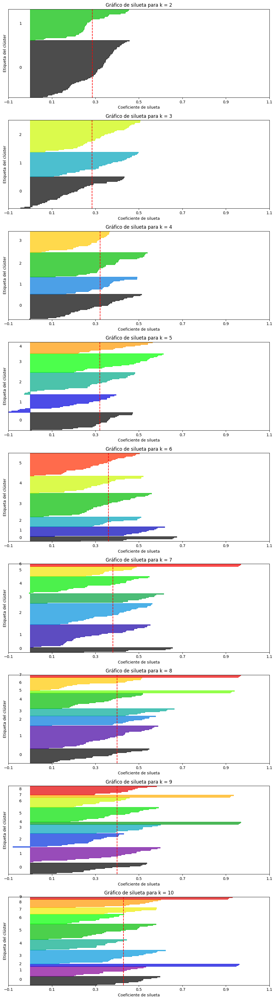

In [ ]:
# Usamos los mismos datos ya escalados y PCA: X_pca
df_mall = X_pca  # renombramos como en tu ejemplo

# Lista de valores de WCSS
wcss = []
n_clusters_range = range(2, 11)

fig, ax = plt.subplots(len(n_clusters_range), 1, figsize=(10, len(n_clusters_range) * 4))

for idx, n_cluster in enumerate(n_clusters_range):
    km = KMeans(n_clusters=n_cluster, init='k-means++', random_state=42, n_init=10)
    preds = km.fit_predict(df_mall)
    sil_coeff = silhouette_score(df_mall, preds)
    print(f"Para n_clusters={n_cluster}, el coeficiente de silueta es {sil_coeff:.3f}")
    wcss.append(km.inertia_)

    sample_silhouette_values = silhouette_samples(df_mall, preds)
    ax[idx].set_title(f"Gráfico de silueta para k = {n_cluster}")
    ax[idx].set_xlabel("Coeficiente de silueta")
    ax[idx].set_ylabel("Etiqueta del clúster")
    ax[idx].set_xlim([-0.1, 1])
    ax[idx].set_ylim([0, len(df_mall) + (n_cluster + 1) * 10])

    y_lower = 10
    for i in range(n_cluster):
        ith_vals = sample_silhouette_values[preds == i]
        ith_vals.sort()
        size_cluster_i = ith_vals.shape[0]
        y_upper = y_lower + size_cluster_i
        color = cm.nipy_spectral(float(i) / n_cluster)
        ax[idx].fill_betweenx(np.arange(y_lower, y_upper), 0, ith_vals,
                              facecolor=color, edgecolor=color, alpha=0.7)
        ax[idx].text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))
        y_lower = y_upper + 10

    ax[idx].axvline(x=sil_coeff, color="red", linestyle="--")
    ax[idx].set_yticks([])
    ax[idx].set_xticks(np.arange(-0.1, 1.1, 0.2))

plt.tight_layout()
plt.show()

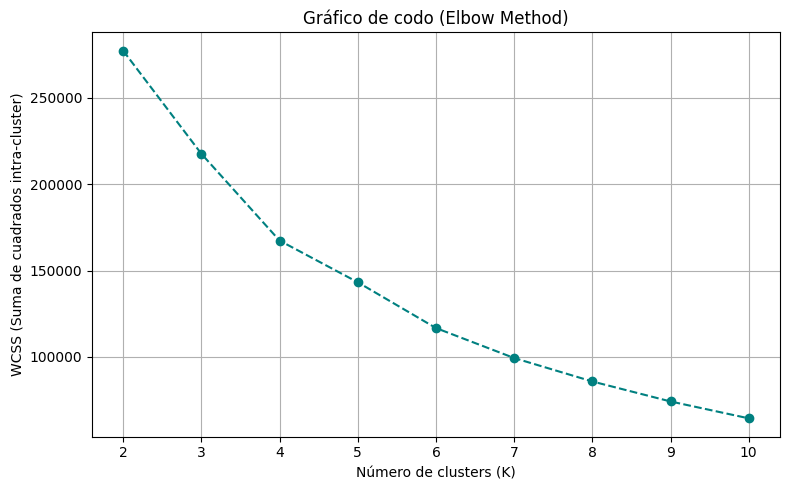

In [ ]:
# Gráfico de codo para ver el "punto de quiebre" en la inercia
plt.figure(figsize=(8, 5))
plt.plot(n_clusters_range, wcss, marker='o', linestyle='--', color='teal')
plt.title('Gráfico de codo (Elbow Method)')
plt.xlabel('Número de clusters (K)')
plt.ylabel('WCSS (Suma de cuadrados intra-cluster)')
plt.xticks(n_clusters_range)
plt.grid(True)
plt.tight_layout()
plt.show()


Si bien k=10 tiene el mejor coeficiente elegimos k=6 ya que sabemos que estamos evaluando 6 genotipos diferentes de soja, con lo cual k=6 es representativo de la diversidad de datos.

In [ ]:
X_unsupervised = df.drop(columns=['Seed Yield per Unit Area (SYUA)'])

cat_cols = ['salicylic_acid', 'water_stress', 'genotype']
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', sparse_output=False), cat_cols)
    ],
    remainder='passthrough'
)
X_encoded = preprocessor.fit_transform(X_unsupervised)
X_scaled = StandardScaler().fit_transform(X_encoded)

pca = PCA(n_components=3)
X_pca = pca.fit_transform(X_scaled)
df_pca = pd.DataFrame(X_pca, columns=['PC1', 'PC2', 'PC3'])

# KMeans con K=6
kmeans = KMeans(n_clusters=6, random_state=42, n_init=10)
clusters = kmeans.fit_predict(X_pca)
df_pca['cluster'] = clusters.astype(str)

# Gráfico 3D PCA + KMeans (K=6)
fig_k6 = px.scatter_3d(
    df_pca, x='PC1', y='PC2', z='PC3',
    color='cluster',
    title='Clústers PCA + KMeans (K=6)',
    color_discrete_sequence=px.colors.qualitative.Set2
)
fig_k6.show()

# Asociar clúster al DataFrame original
df['cluster'] = df_pca['cluster']

# Resumen estadístico del rendimiento por clúster
resumen_syua = df.groupby('cluster')['Seed Yield per Unit Area (SYUA)'].agg(['mean', 'std', 'count']).round(2)
print("📊 Rendimiento por clúster (K=6):")
print(resumen_syua)

📊 Rendimiento por clúster (K=6):
            mean      std  count
cluster                         
0        3880.90  1616.34   3080
1        3939.41   719.95   6160
2        4430.89   800.55   6163
3        4355.39  1272.40  14890
4        5561.45  1299.15  10783
5        3826.02   741.87  14374


De los rendimientos por cluster podemos ver que el de mayor rendimiento promedio es el cluster 4, por lo cual seria interesante saber que genotipos estan asociados al mismo, también podriamos evaluar que combinaciones de ácido salicílico y estrés hídrico predominan en este cluster.

In [ ]:
# Agrupar rendimiento promedio (ya tenés el DataFrame 'resumen_syua', si no lo creaste aún):
resumen_syua = df.groupby('cluster')['Seed Yield per Unit Area (SYUA)'].agg(['mean', 'std', 'count']).round(2).reset_index()

# Gráfico de barras del rendimiento medio
fig_mean = px.bar(
    resumen_syua,
    x='cluster',
    y='mean',
    error_y='std',
    text='mean',
    color='cluster',
    title='🌾 Rendimiento promedio por clúster (SYUA)',
    labels={'mean': 'Rendimiento promedio (SYUA)', 'cluster': 'Clúster'},
    color_discrete_sequence=px.colors.qualitative.Set2
)
fig_mean.update_traces(texttemplate='%{text:.1f}', textposition='outside')
fig_mean.update_layout(yaxis=dict(title='SYUA'), xaxis=dict(type='category'))
fig_mean.show()

In [ ]:
# Frecuencia de genotipos dentro del clúster 4
gen_cluster4 = df[df['cluster'] == '4']['genotype'].value_counts().reset_index()
gen_cluster4.columns = ['genotype', 'count']

# Gráfico
fig_gen = px.bar(gen_cluster4, x='genotype', y='count', color='genotype',
                 title='🧬 Genotipos en el clúster 4 (mayor rendimiento)',
                 color_discrete_sequence=px.colors.qualitative.Set2)
fig_gen.show()


In [ ]:
# Combinaciones de tratamientos en el clúster 4
combo_cluster4 = (
    df[df['cluster'] == '4']
    .groupby(['salicylic_acid', 'water_stress'])
    .size()
    .reset_index(name='count')
)

# Gráfico
fig_combo = px.bar(combo_cluster4, x='salicylic_acid', y='count',
                   color='water_stress', barmode='group',
                   title='🌿 Tratamientos predominantes en clúster 4',
                   labels={'count': 'Cantidad de muestras'},
                   color_discrete_sequence=px.colors.qualitative.Set1)
fig_combo.show()


In [ ]:
rend_gen = (
    df[df['cluster'] == '4']
    .groupby('genotype')['Seed Yield per Unit Area (SYUA)']
    .agg(['mean', 'std', 'count'])
    .round(2)
    .sort_values('mean', ascending=False)
)
print("📈 Rendimiento promedio por genotipo en clúster 4:")
print(rend_gen)


📈 Rendimiento promedio por genotipo en clúster 4:
             mean      std  count
genotype                         
G5        6785.21   118.09   1541
G3        6392.89  1254.47   3081
G1        5594.46   152.34   1540
G2        4588.01   984.24   4621


In [ ]:
rend_combo = (
    df[df['cluster'] == '4']
    .groupby(['salicylic_acid', 'water_stress'])['Seed Yield per Unit Area (SYUA)']
    .agg(['mean', 'std', 'count'])
    .round(2)
    .sort_values('mean', ascending=False)
)
print("📊 Rendimiento promedio por tratamiento (ácido + estrés hídrico) en clúster 4:")
print(rend_combo)


📊 Rendimiento promedio por tratamiento (ácido + estrés hídrico) en clúster 4:
                                mean     std  count
salicylic_acid water_stress                        
C1             S3            6357.35  925.18   6163
               S1            5134.25   96.54   1540
C2             S3            4182.49  965.01   3080


De este análisis podemos deducir cuál es el genotipo con mayor rendimiento (G5) y también que tipo de tratamiento produce mejores rendimientos en el cultivo. Suponiendo que siempre conocemos el genotipo de soja que utilizamos para producir, una herramienta muy útil seria poder determinar a partir del genotipo que tratamiento es el adecuado para generar mayores rendimientos, el siguiente winget esta pensado con ese objetivo.

In [ ]:
# Widget desplegable para elegir genotipo
genotipo_dropdown = widgets.Dropdown(
    options=sorted(df['genotype'].unique()),
    description='Genotipo:',
    style={'description_width': 'initial'},
    layout=widgets.Layout(width='300px')
)

# Función que responde a la selección
def recomendar_tratamiento(genotipo):
    df_filtrado = df[df['genotype'] == genotipo]

    resumen = (
        df_filtrado
        .groupby(['salicylic_acid', 'water_stress'])['Seed Yield per Unit Area (SYUA)']
        .agg(['mean', 'count'])
        .round(2)
        .sort_values('mean', ascending=False)
        .reset_index()
    )

    print(f"\n🌱 Recomendaciones para el genotipo {genotipo} (ordenado por rendimiento promedio):\n")
    display(resumen.head(3))  # Mostramos las 3 combinaciones con mejor rendimiento

# Mostrar el widget y vincularlo a la función
widgets.interact(recomendar_tratamiento, genotipo=genotipo_dropdown)

interactive(children=(Dropdown(description='Genotipo:', layout=Layout(width='300px'), options=('G1', 'G2', 'G3…

<function __main__.recomendar_tratamiento(genotipo)>

##  Pipeline 2: Predicción de rendimiento con Random Forest y XGBoost

In [ ]:
# Variables predictoras y objetivo
X = df_modelo.drop(columns=['Seed Yield per Unit Area (SYUA)'])
y = df_modelo['Seed Yield per Unit Area (SYUA)']

In [ ]:
# Variables categóricas
cat_cols = ['salicylic_acid', 'water_stress', 'genotype']

# ColumnTransformer con OneHotEncoding
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', sparse_output=False), cat_cols)
    ],
    remainder='passthrough'  # el resto se mantiene igual
)

# Transformar X
X_encoded = preprocessor.fit_transform(X)

# Obtener nombres de columnas
encoded_col_names = preprocessor.named_transformers_['cat'].get_feature_names_out(cat_cols)
num_col_names = [col for col in X.columns if col not in cat_cols]
final_col_names = list(encoded_col_names) + num_col_names

# Convertir a DataFrame
X_encoded_df = pd.DataFrame(X_encoded, columns=final_col_names)


In [ ]:
#division de los datos
X_train, X_test, y_train, y_test = train_test_split(X_encoded_df, y, test_size=0.2, random_state=42)


In [ ]:
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

In [ ]:
rf = RandomForestRegressor(random_state=42)
rf.fit(X_train, y_train)
y_pred_rf = rf.predict(X_test)

In [ ]:
xgb = XGBRegressor(random_state=42, n_estimators=100, max_depth=5, verbosity=0)
xgb.fit(X_train_scaled, y_train)
y_pred_xgb = xgb.predict(X_test_scaled)

In [ ]:
def evaluar(y_true, y_pred):
    mae = mean_absolute_error(y_true, y_pred)
    rmse = np.sqrt(mean_squared_error(y_true, y_pred))
    r2 = r2_score(y_true, y_pred)
    return mae, rmse, r2

mae_rf, rmse_rf, r2_rf = evaluar(y_test, y_pred_rf)
mae_xgb, rmse_xgb, r2_xgb = evaluar(y_test, y_pred_xgb)

# Mostrar resultados
print("🔎 Random Forest:")
print(f"MAE: {mae_rf:.2f}, RMSE: {rmse_rf:.2f}, R²: {r2_rf:.3f}")
print("\n⚡ XGBoost:")
print(f"MAE: {mae_xgb:.2f}, RMSE: {rmse_xgb:.2f}, R²: {r2_xgb:.3f}")


🔎 Random Forest:
MAE: 0.00, RMSE: 0.00, R²: 1.000

⚡ XGBoost:
MAE: 0.00, RMSE: 0.00, R²: 1.000


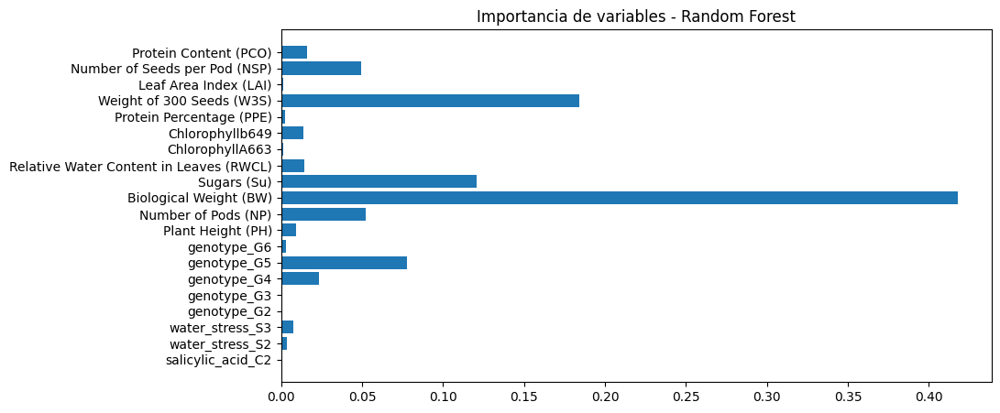

In [ ]:
importances = rf.feature_importances_
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 5))
plt.barh(final_col_names, importances)
plt.title("Importancia de variables - Random Forest")
plt.show()


Del gráfico podemos ver que el peso biológico de las plantas explica más del 40% del modelo, es decir que esta fuertemente correlacionada con el rendimiento que es lo que queremos predecir, lo mismo pasa con el peso de las semillas, contenido de azucar y el genotipo 5 lo cual coincide con el EDA y el análisis exploratorio hecho previamente. Aun así las métricas de evaluación no parecen reales, sugieren que ambos métodos no tienen margen de error. Mi investigación sobre estos resultados me sugiere que se debe a un sobreajuste, que podría deberse a que algunas variables como el peso estan biologicamente ligadas al rendimiento, por lo cual el modelo lo predice sin error.  Por todo esto, hago un segundo análisis de los modelos tomando en cuenta solo las variables categóricas, que son el genotipo que es informacion de la semilla que voy a cultivar y por otro lado ácido salicílico y estrés hídrico que son las condiciones de siembra y cultivo.

## Segundo análisis

In [ ]:
# Seleccionar variables de tratamiento
X = df[['genotype', 'salicylic_acid', 'water_stress']]
y = df['Seed Yield per Unit Area (SYUA)']

# Preprocesamiento con OneHotEncoder
cat_cols = ['genotype', 'salicylic_acid', 'water_stress']
preprocessor = ColumnTransformer(
    transformers=[
        ('cat', OneHotEncoder(drop='first', sparse_output=False), cat_cols)
    ],
    remainder='passthrough'
)
X_encoded = preprocessor.fit_transform(X)

# División train/test
X_train, X_test, y_train, y_test = train_test_split(X_encoded, y, test_size=0.2, random_state=42)

# Random Forest
rf = RandomForestRegressor(random_state=42)
rf.fit(X_train, y_train)
y_pred_rf = rf.predict(X_test)

# XGBoost
xgb = XGBRegressor(random_state=42, n_estimators=100, max_depth=5, verbosity=0)
xgb.fit(X_train, y_train)
y_pred_xgb = xgb.predict(X_test)

# Función de evaluación
def evaluar(y_true, y_pred):
    return {
        "MAE": round(mean_absolute_error(y_true, y_pred), 2),
        "RMSE": round(np.sqrt(mean_squared_error(y_true, y_pred)), 2),
        "R²": round(r2_score(y_true, y_pred), 3)
    }

# Resultados
print("🌱 Random Forest (solo tratamientos):", evaluar(y_test, y_pred_rf))
print("⚡ XGBoost (solo tratamientos):", evaluar(y_test, y_pred_xgb))

🌱 Random Forest (solo tratamientos): {'MAE': 210.68, 'RMSE': np.float64(398.58), 'R²': 0.898}
⚡ XGBoost (solo tratamientos): {'MAE': 210.86, 'RMSE': np.float64(398.65), 'R²': 0.898}


Estas métricas si me permiten deducir resultados reales: en promedio ambos modelos se equivocan en predecir aproximadamente 210 kg por hectárea y explican casi el 90% de la variabilidad del rendimiento usando solo el genotipo de la semilla y el tratamiento en la siembra. Para complementar el Winget basado en kmeans, agrego el siguiente winget basado en Random Forest para calcular el rendimiento.

In [ ]:
# Opciones según tu dataset
genotipo_opciones = sorted(df['genotype'].unique())
estres_opciones = sorted(df['water_stress'].unique())
acido_opciones = sorted(df['salicylic_acid'].unique())

# Widgets interactivos
gen_widget = widgets.Dropdown(options=genotipo_opciones, description='Genotipo:')
estres_widget = widgets.Dropdown(options=estres_opciones, description='Estrés hídrico:')
acido_widget = widgets.Dropdown(options=acido_opciones, description='Ácido salicílico:')
btn = widgets.Button(description='📈 Predecir rendimiento', button_style='success')
salida = widgets.Output()

# Función de predicción
def predecir_rendimiento(b):
    entrada = pd.DataFrame([{
        'genotype': gen_widget.value,
        'salicylic_acid': acido_widget.value,
        'water_stress': estres_widget.value
    }])

    # Aplicar el preprocesamiento original
    X_input = preprocessor.transform(entrada)
    pred = rf.predict(X_input)[0]

    with salida:
        salida.clear_output()
        print(f"🌾 Predicción de rendimiento para {gen_widget.value} con {acido_widget.value} y {estres_widget.value}:")
        print(f"🔮 SYUA estimado: {pred:.2f} kg/ha")

# Conectar botón con función
btn.on_click(predecir_rendimiento)

# Mostrar todo junto
display(widgets.VBox([gen_widget, estres_widget, acido_widget, btn, salida]))

De esta manera aplicando el modelo no supervisado Kmeans puedo evaluar cual es el mejor tratamiento de siembra para cada genotipo (si quisiera avaluar los genotipos según sus características fisiológicas y biológicas para investigación por ejemplo también podria hacerlo con este modelo) y por otro lado con un modelo supervisado como Random Forest puedo predecir con un error mínimo el rendimiento de la cosecha.

## Análisis de económico

💡 Supuestos para el análisis monetario (pueden ajustarse):

Parámetro	Valor de referencia

Precio de la soja	USD 500 / tonelada (0.5 USD/kg)

Costo de tratamiento C1	10 USD/ha

Costo de tratamiento C2	25 USD/ha

Estrés hídrico S1 (riego alto)	20 USD/ha

Estrés hídrico S2 (medio)	10 USD/ha

Estrés hídrico S3 (bajo/sin riego)	0 USD/ha

In [ ]:
df_monetizacion = df[['genotype', 'salicylic_acid', 'water_stress']].copy()
df_monetizacion['pred_SYUA'] = rf.predict(preprocessor.transform(df_monetizacion))  # en kg/ha
df_monetizacion['ingreso'] = df_monetizacion['pred_SYUA'] * 0.5  # USD/ha

In [ ]:
# Costos ácido
costos_acido = {'C1': 10, 'C2': 25}
df_monetizacion['costo_acido'] = df_monetizacion['salicylic_acid'].map(costos_acido)

# Costos estrés hídrico
costos_agua = {'S1': 20, 'S2': 10, 'S3': 0}
df_monetizacion['costo_agua'] = df_monetizacion['water_stress'].map(costos_agua)

# Costo total de tratamiento
df_monetizacion['costo_total'] = df_monetizacion['costo_acido'] + df_monetizacion['costo_agua']


In [ ]:
df_monetizacion['ganancia_neta'] = df_monetizacion['ingreso'] - df_monetizacion['costo_total']

In [ ]:
resumen_final = (
    df_monetizacion
    .groupby(['genotype', 'salicylic_acid', 'water_stress'])[['pred_SYUA', 'ingreso', 'costo_total', 'ganancia_neta']]
    .mean()
    .round(2)
    .sort_values('ganancia_neta', ascending=False)
    .reset_index()
)

print("💰 Recomendaciones ordenadas por ganancia neta estimada:")
display(resumen_final.head(10))


💰 Recomendaciones ordenadas por ganancia neta estimada:


,genotype,salicylic_acid,water_stress,pred_SYUA,ingreso,costo_total,ganancia_neta
0,G3,C1,S3,7641.07,3820.54,10.0,3810.54
1,G5,C1,S3,6786.04,3393.02,10.0,3383.02
2,G1,C1,S1,6321.28,3160.64,30.0,3130.64
3,G5,C1,S2,5668.19,2834.10,20.0,2814.10
4,G1,C1,S3,5595.37,2797.68,10.0,2787.68
5,G5,C1,S1,5560.61,2780.31,30.0,2750.31
6,G5,C2,S3,5487.60,2743.80,25.0,2718.80
7,G2,C1,S3,5406.28,2703.14,10.0,2693.14
8,G4,C2,S1,5439.67,2719.83,45.0,2674.83
9,G3,C2,S3,5144.49,2572.25,25.0,2547.25


Este análisis nos permite ver que combinaciones de genotipo y tratamiento son las de mayor rendimiento y también nos permite evaluar el costo y la productividad teniendo en cuenta posibles gastos en el tratamiento del cultivo.

In [ ]:
# Creamos una nueva columna descriptiva de combinación
resumen_final['tratamiento'] = (
    resumen_final['salicylic_acid'] + ' + ' +
    resumen_final['water_stress'] + ' (G=' + resumen_final['genotype'] + ')'
)

# Ordenamos por ganancia
resumen_final = resumen_final.sort_values('ganancia_neta', ascending=False)

# Gráfico interactivo
fig_ganancia = px.bar(
    resumen_final,
    x='tratamiento',
    y='ganancia_neta',
    color='genotype',
    title='💰 Ganancia neta estimada por combinación (genotipo + tratamiento)',
    labels={'ganancia_neta': 'Ganancia neta (USD/ha)', 'tratamiento': 'Combinación de tratamiento'},
    text='ganancia_neta',
    color_discrete_sequence=px.colors.qualitative.Set2
)

fig_ganancia.update_traces(texttemplate='%{text:.0f}', textposition='outside')
fig_ganancia.update_layout(xaxis_tickangle=-45, yaxis=dict(title='USD/ha'), height=600)
fig_ganancia.show()


## Conclusiones

🌱 1. Análisis exploratorio (EDA)

Se exploró un conjunto de datos agronómicos avanzado de soja con más de 55.000 observaciones y múltiples variables fisiológicas, morfológicas y de tratamiento.

El análisis inicial evidenció correlaciones fuertes entre el rendimiento (SYUA) y variables como peso biológico (BW), número de vainas (NP), contenido de azúcares, clorofilas y agua en hojas.

Se identificaron patrones de respuesta preliminares entre genotipos, nivel de estrés hídrico y aplicación de ácido salicílico.

🔍 2. Reducción de dimensionalidad + KMeans (no supervisado)

Se aplicó PCA para reducir la dimensionalidad del dataset manteniendo la mayor varianza explicada.

Con los datos transformados se aplicó KMeans para detectar agrupamientos naturales en los datos.

Se determinó que K=6 era un valor óptimo (alineado con los 6 genotipos experimentales), aunque métricas como el coeficiente de silueta sugirieron que K=10 ofrecía la máxima separación.

Se observó que ciertos clústers (especialmente el clúster 4) tenían rendimientos promedio significativamente mayores, lo que permitió identificar combinaciones de genotipo y tratamiento preferibles.

🌳 3. Modelado predictivo (Random Forest y XGBoost)

Se construyeron modelos supervisados para predecir el rendimiento (SYUA):

Primero con todas las variables fisiológicas,

Luego solo solo con los factores de tratamiento (genotype, salicylic_acid, water_stress).

Los modelos entrenados solo con los tratamientos lograron un excelente rendimiento:

MAE ≈ 210 kg/ha, R² ≈ 0.898

Lo que demuestra que la combinación de genotipo y tratamiento explica gran parte del rendimiento potencial.

Se construyó un widget interactivo para ingresar combinaciones y obtener una predicción automática del rendimiento.

💰 4. Evaluación económica
Se simuló un análisis de monetización basado en:

Precio estimado de la soja por tonelada,

Costos de aplicación de ácido salicílico y riego,

Rendimiento predicho por el modelo.

El resultado permitió calcular:

Ingresos estimados por hectárea

Costo total del tratamiento

Ganancia neta para cada combinación de tratamiento y genotipo

Se visualizó la ganancia neta en gráficos de barras, identificando combinaciones altamente rentables como base para recomendación agronómica aplicada.

🌟 Conclusión final

Este trabajo integró técnicas de análisis exploratorio, reducción de dimensionalidad, aprendizaje no supervisado, aprendizaje supervisado y monetización para identificar tratamientos de soja más productivos y rentables según genotipo y condiciones de estrés.

Se evidenció que el rendimiento de soja puede predecirse con alta precisión utilizando únicamente factores conocidos antes de la cosecha, lo cual permite aplicar estas técnicas en escenarios reales de toma de decisiones.

In [ ]:
import nbformat
import os
from ipykernel import kernelspec

# Get the current notebook path if available (requires running in a notebook)
# This is a common way to get the current notebook's path in Colab or Jupyter
try:
    from google.colab import runtime
    # This might return None in some environments
    archivo = runtime.get_client_notebook_path()
except Exception:
    # Fallback for other environments, may require user input or might not work universally
    # You might need to manually set archivo if this fails and you're not in Colab
    print("Could not automatically detect notebook path. Please set 'archivo' manually.")
    archivo = 'DSII_JennyCuba_EntregaFinal.ipynb' # Keep your original fallback

if archivo and os.path.exists(archivo):
    # Leer el notebook
    # Open the file in binary read mode ('rb') and then read its content
    with open(archivo, 'r', encoding='utf-8') as f:
        nb = nbformat.read(f, as_version=4)

    # Eliminar metadatos de widgets si están presentes
    if 'widgets' in nb.get('metadata', {}): # Use .get for safe access
        del nb['metadata']['widgets']

    # Guardar el archivo limpio
    # Open the file in binary write mode ('wb') for saving
    with open(archivo, 'w', encoding='utf-8') as f:
        nbformat.write(nb, f)

    print(f"✅ Notebook '{archivo}' limpio guardado")
else:
    print(f"❌ Error: Notebook file not found at '{archivo}'. Please check the path or filename.")

Could not automatically detect notebook path. Please set 'archivo' manually.
❌ Error: Notebook file not found at 'DSII_JennyCuba_EntregaFinal.ipynb'. Please check the path or filename.
